# These coeds are largely based on https://pietromarchesi.net/pca-neural-data.html#Animated-PCA-trajectories-of-single-trials-in-3D

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
# import torchvision.transforms as transforms
# import torchvision.datasets as datasets
from torch.utils.data import DataLoader
from torch.utils.data.sampler import SubsetRandomSampler
import numpy as np
from sklearn.preprocessing import StandardScaler

In [3]:
import os, requests

fname = []
for j in range(3):
  fname.append('steinmetz_part%d.npz'%j)
url = ["https://osf.io/agvxh/download"]
url.append("https://osf.io/uv3mw/download")
url.append("https://osf.io/ehmw2/download")

for j in range(len(url)):
  if not os.path.isfile(fname[j]):
    try:
      r = requests.get(url[j])
    except requests.ConnectionError:
      print("!!! Failed to download data !!!")
    else:
      if r.status_code != requests.codes.ok:
        print("!!! Failed to download data !!!")
      else:
        with open(fname[j], "wb") as fid:
          fid.write(r.content)
          
alldat = np.array([])
for j in range(len(fname)):
  alldat = np.hstack((alldat,
                      np.load('steinmetz_part%d.npz'%j,
                              allow_pickle=True)['dat']))

In [4]:
basal_ganglia_regions = ["ACB", "CP", "GPe", "LS", "LSc", "LSr", "MS", "OT", "SNr", "SI"]
visual_cortex_regions = ["VISa", "VISam", "VISl", "VISp", "VISpm", "VISrl"]

total_vc_neurons=0
total_bg_neurons=0

sessions_to_use = []  ##Session indices
session_lengths = []  ##The number of trials in each session
input_visual_tensor_list = []
label_basal_tensor_list = []

for session in range(len(alldat)):
  num_vis_neurons = 0
  num_basal_neurons = 0
  vis_neuron_indices = []
  basal_neuron_indices = []
  for neuron_idx, area in enumerate(alldat[session]['brain_area']):
    if area in visual_cortex_regions:  ## Viusal areas
      num_vis_neurons += 1
      vis_neuron_indices.append(neuron_idx)
    if area in basal_ganglia_regions:  ## Basal Ganglia
      num_basal_neurons += 1
      basal_neuron_indices.append(neuron_idx)
          
  trial_num = alldat[session]['spks'].shape[1]   
  input_visual_recordings = np.empty((num_vis_neurons, trial_num, 250))
  label_basal_recordings = np.empty((num_basal_neurons, trial_num, 250))
  
  
  if num_vis_neurons*num_basal_neurons != 0:
    sessions_to_use.append(session)
    print("session " ,session, "has both visual and basal!")
    print('The name of the mouse: ' + alldat[session]['mouse_name'])
    print('The session time' + alldat[session]['date_exp'])
    print(alldat[session]['spks'].shape)

    print('The number of neurons being recorded:', len(alldat[session]['spks']))
    print('Number of visual neurons: ', num_vis_neurons)
    # print('Indices of visual neurons: ', vis_neuron_indices)
    
    ## To extract the data from alldat[current_session]
    for i, v in enumerate(vis_neuron_indices): 
      input_visual_recordings[i, :, :] = alldat[session]['spks'][v, :, :]
    print("reorganized visual activities for input: ", input_visual_recordings.shape)
    print('Number of basal neurons: ', num_basal_neurons)
    # print('Indices of basal neurons: ', basal_neuron_indices)
    for i, g in enumerate(basal_neuron_indices):
      label_basal_recordings[i, :, :] = alldat[session]['spks'][g, :, :]
    print("reorganized basal activities for label", label_basal_recordings.shape)
    print('----------------------------------------------------')
    
    visual_input_tensor = torch.from_numpy(input_visual_recordings).reshape(-1, 250)
    input_visual_tensor_list.append(visual_input_tensor)
    basal_label_tensor = torch.from_numpy(label_basal_recordings).reshape(-1, 250)
    label_basal_tensor_list.append(basal_label_tensor)

# input = torch.cat(input_visual_tensor_list, axis = 0)
# label = torch.cat(label_basal_tensor_list, axis = 0)
# !!!!!! I realized that the firing rate across different sessions have huge variations, so it may not be a good idea to combine them together!!!!!\

print("input tensor list: We have", len(input_visual_tensor_list), "and their shapes are ", [input_visual_tensor_list[i].shape for i in range(len(input_visual_tensor_list))])
print("label tensor list: We have", len(label_basal_tensor_list), "and their shapes are", [label_basal_tensor_list[i].shape for i in range(len(label_basal_tensor_list))])


session  0 has both visual and basal!
The name of the mouse: Cori
The session time2016-12-14
(734, 214, 250)
The number of neurons being recorded: 734
Number of visual neurons:  178
reorganized visual activities for input:  (178, 214, 250)
Number of basal neurons:  139
reorganized basal activities for label (139, 214, 250)
----------------------------------------------------
session  3 has both visual and basal!
The name of the mouse: Forssmann
The session time2017-11-01
(1769, 249, 250)
The number of neurons being recorded: 1769
Number of visual neurons:  120
reorganized visual activities for input:  (120, 249, 250)
Number of basal neurons:  435
reorganized basal activities for label (435, 249, 250)
----------------------------------------------------
session  7 has both visual and basal!
The name of the mouse: Hench
The session time2017-06-15
(1156, 250, 250)
The number of neurons being recorded: 1156
Number of visual neurons:  111
reorganized visual activities for input:  (111, 250,

`alldat` contains 39 sessions from 10 mice, data from Steinmetz et al, 2019. Time bins for all measurements are 10ms, starting 500ms before stimulus onset. The mouse had to determine which side has the highest contrast. For each `dat = alldat[k]`, you have the fields below. For extra variables, check out the extra notebook and extra data files (lfp, waveforms and exact spike times, non-binned). 

* `dat['mouse_name']`: mouse name
* `dat['date_exp']`: when a session was performed
* `dat['spks']`: neurons by trials by time bins.    
* `dat['brain_area']`: brain area for each neuron recorded. 
* `dat['ccf']`: Allen Institute brain atlas coordinates for each neuron. 
* `dat['ccf_axes']`: axes names for the Allen CCF. 
* `dat['contrast_right']`: contrast level for the right stimulus, which is always contralateral to the recorded brain areas.
* `dat['contrast_left']`: contrast level for left stimulus. 
* `dat['gocue']`: when the go cue sound was played. 
* `dat['response_time']`: when the response was registered, which has to be after the go cue. The mouse can turn the wheel before the go cue (and nearly always does!), but the stimulus on the screen won't move before the go cue.  
* `dat['response']`: which side the response was (`-1`, `0`, `1`). When the right-side stimulus had higher contrast, the correct choice was `-1`. `0` is a no go response. 
* `dat['feedback_time']`: when feedback was provided. 
* `dat['feedback_type']`: if the feedback was positive (`+1`, reward) or negative (`-1`, white noise burst).  
* `dat['wheel']`: turning speed of the wheel that the mice uses to make a response, sampled at `10ms`. 
* `dat['pupil']`: pupil area  (noisy, because pupil is very small) + pupil horizontal and vertical position.
* `dat['face']`: average face motion energy from a video camera. 
* `dat['licks']`: lick detections, 0 or 1.   
* `dat['trough_to_peak']`: measures the width of the action potential waveform for each neuron. Widths `<=10` samples are "putative fast spiking neurons". 
* `dat['%X%_passive']`: same as above for `X` = {`spks`, `pupil`, `wheel`, `contrast_left`, `contrast_right`} but for  passive trials at the end of the recording when the mouse was no longer engaged and stopped making responses. 
* `dat['prev_reward']`: time of the feedback (reward/white noise) on the previous trial in relation to the current stimulus time. 
* `dat['reaction_time']`: ntrials by 2. First column: reaction time computed from the wheel movement as the first sample above `5` ticks/10ms bin. Second column: direction of the wheel movement (`0` = no move detected).  


The original dataset is here: https://figshare.com/articles/dataset/Dataset_from_Steinmetz_et_al_2019/9598406

In [6]:
### 2024/07/15 We set the turncation threshold to be 50 neurons
## adding reshape methods -- please go over the code to see if modified/added "aspects" are consistent 
## and do what they are intended to do, the number of neurons went down (perhaps a little bit more than intended)
## and the same for the trial number, but now they match in dimensions

import torch 
from torch.utils.data import Dataset

class CustomDataset(Dataset):

    """
    I tried to make it tailored to our needs.
    It only considers sessions that have both visual and basal ganglia recordings.
    It only considers go trials.
    When indexed, it returns basal ganglia spikes and action).
    """

    def __init__(
        self,
        data,
        visual_cortex_regions: list = ["VISa", "VISam", "VISl", "VISp", "VISpm", "VISrl"], # Put them as default argument so they can be easily changed if we decide to change areas
        basal_ganglia_regions: list = ["ACB", "CP", "GPe", "LS", "LSc", "LSr", "MS", "OT", "SNr", "SI"],
        thresh=50
    ) -> None:
        
        self.visual_cortex_regions = visual_cortex_regions
        self.basal_ganglia_regions = basal_ganglia_regions
        self.thresh=thresh
        self.data = self.visual_and_basal(data)
        self.data = self.get_go_trials(self.data)
        self.min_trials, self.min_neurons = self.find_min_dimensions(self.data) # new 
        print(f"Minimum number of trials: {self.min_trials}")
        print(f"Minimum number of neurons: {self.thresh}")

    def __getitem__(
        self,
        session_index: int
    ) -> torch.tensor:
        
        session = self.data[session_index]
        
        # We need visual spikes now!!!
        # input_visual_spks = self.get_truncated_spikes(session, self.visual_cortex_regions)
        
        ## Some number checks by Yangdong 24/7/15
        ## print("the shape of spikes_visual after truncating:", spikes_visual.shape)

        input_basal_spks = self.get_truncated_spikes(session, self.basal_ganglia_regions) # This will be the input data (time, trials, eurons_indicies)          
        label_action = torch.tensor(session['response'][0:self.min_trials]) #(-1: the mouse is turning the wheel to the left, which indicates that the mouse thinks the right side has higher contrast level. )
        
        return input_basal_spks, label_action

    def __len__(self):
      return len(self.data)

    def visual_and_basal(
        self,
        data: np.array
    ) -> list:
        """
        It checks whether any of the considered brain areas recorded in the session
        is present in both visual or basal regions.
        Also excludes sessions with a number of neurons < self.threshold
        """
      
        visual_and_basal_sessions = []
        for session in data:
        
            visual_ok = any(area in self.visual_cortex_regions for area in session["brain_area"]) 
            basal_ok = any(area in self.basal_ganglia_regions for area in session["brain_area"]) 
            vis_neuron_count = len([i for i, area in enumerate(session["brain_area"]) if area in self.visual_cortex_regions])
            bg_neuron_count = len([i for i, area in enumerate(session["brain_area"]) if area in self.basal_ganglia_regions])
            min_count = np.min([vis_neuron_count, bg_neuron_count])

            if visual_ok and basal_ok and min_count>self.thresh:
                visual_and_basal_sessions.append(session)

        return visual_and_basal_sessions  
        ## a list of actual sessions (with all datas) which contains both, and the number of neurons is larger than the threshold...

    def get_go_trials(
        self,
        data: list
    ) -> list:
        """
        Within sessions, excludes no-go trials.
        """
        sessions_with_go_trials = []
        for session in data:
            go_trial_indices = [i for i, response in enumerate(session["response"]) if response != 0]
            if go_trial_indices:
                filtered_session = {} # sessions are dicts
                for key, value in session.items():
                    # Include all the keys of the session dictionary
                    if isinstance(value, np.ndarray) and value.ndim > 1 and value.shape[1] == len(session["response"]): # like "spks" is multidimensional
                        filtered_session[key] = value[:, go_trial_indices]
                    elif isinstance(value, np.ndarray) and len(value) == len(session["response"]): # like "response is 1 dimensional"
                        filtered_session[key] = value[go_trial_indices]
                    else: # like "mouse_name" is a single value
                        filtered_session[key] = value
                sessions_with_go_trials.append(filtered_session)
        
        return sessions_with_go_trials  

    def find_min_dimensions(
        self,
        data: list
    ) -> tuple:
        min_trials = float('inf')
        min_neurons = float('inf')
        """
        Helper function to establish """        
        
        for session in data:
            spikes = session["spks"]  ## [neurons_number, trial_Indexes, time]
            min_trials = min(min_trials, spikes.shape[1])
            # min_neurons = min(min_neurons, spikes.shape[0])
        
        return min_trials, min_neurons

    def get_truncated_spikes(
        self,
        session: dict,
        regions: list
    ) -> torch.tensor:

        neuron_indices = [i for i, area in enumerate(session["brain_area"]) if area in regions]
        spikes = session["spks"][neuron_indices, :, :]  ## containing spks from visual/basal areas, e.g 17
        spikes = spikes[:self.thresh, :, :] 
        spikes = spikes[:, :self.min_trials, :]

        spikes = torch.tensor(spikes)
        spikes = torch.permute(spikes, (2,0,1))  ## time, neuron_index, trial_index

        # 24/07/15 -> Dario: should we leave the conversion to tensor in the __getitem__ method?

        return spikes
    
    def sanity_check(self):
        for idx, session in enumerate(self.data):
            spikes_visual = self.get_truncated_spikes(session, self.visual_cortex_regions)
            spikes_basal = self.get_truncated_spikes(session, self.basal_ganglia_regions)

            assert spikes_visual.shape[1] == self.min_trials, f"Session idx visual cortex trials mismatch."
            assert spikes_visual.shape[2] == self.min_neurons, f"Session idx visual cortex neurons mismatch."
            assert spikes_basal.shape[1] == self.min_trials, f"Session idx basal ganglia trials mismatch."
            assert spikes_basal.shape[2] == self.min_neurons, f"Session idx basal ganglia neurons mismatch."
    print("Sanity check clear")

thresh=50
all_data = CustomDataset(alldat)
x = all_data[0]

print("We have", len(all_data), "number of sessions.")
print("Each of the session has", all_data[0][0].shape[2], "trials, and", all_data[0][0].shape[1], "neurons.")
print("We have", 123*6, "input basal spike matrx.")

Sanity check clear
Minimum number of trials: 123
Minimum number of neurons: 50
We have 6 number of sessions.
Each of the session has 123 trials, and 50 neurons.
We have 738 input basal spike matrx.


In [7]:
# a = (all_data[0][0], all_data[0][1])  # Initialize 'a' with the first tuple's tensors.

merged = all_data[0]

for i, session in enumerate(all_data):  # Start from the second element.
    # print(i)
    if i == 0: continue
    merged = (torch.cat((merged[0], session[0]), dim=2),  # Concatenate along dim=2 for the first tensor.
         torch.cat((merged[1], session[1])))         # Simply concatenate along the last dimension for the second tensor.

print(merged[0].shape, merged[1].shape)

torch.Size([250, 50, 738]) torch.Size([738])


In [10]:
def z_score(X):
    # X: ndarray, shape (n_features, n_samples)
    ss = StandardScaler(with_mean=True, with_std=True)
    Xz = ss.fit_transform(X.T).T
    return Xz

X = np.array([[5., 6., 5.],
              [50., 60., 50.]]) # data array of shape n_neuron by n_time_points
X = z_score(X)
c = np.cov(X, rowvar=True) # covariance matrix
eig_vals, eig_vecs = np.linalg.eig(c)
srt = np.argsort(eig_vals)[::-1]
print('Sorted eigenvalues: \n{}'.format(eig_vals[srt]))
print('\nFirst eigenvector: \n{}'.format(eig_vecs[:, srt][:, 0]))

Sorted eigenvalues: 
[3. 0.]

First eigenvector: 
[0.70710678 0.70710678]


In [53]:
actions = list(merged[1])
for i in range(len(actions)):
    actions[i] = actions[i].item()
action_types = [1.0, -1.0]
trials = []
for i in range(merged[0].shape[2]):
    trials.append(merged[0][:, :, i])
for i in range(len(trials)):
    trials[i] = torch.transpose(trials[i], 0, 1)
    trials[i] = trials[i].numpy()


trial_size   = trials[0].shape[1]
Nneurons     = trials[0].shape[0]
time = np.linspace(0, trial_size, 250)

In [42]:
action_type_ind = [np.argwhere(np.array(action_types) == a_type)[:, 0] for a_type in actions]

* `trials` is a list of K Numpy arrays of shape N×T (number of neurons by number of time points).
* `trial_type` is a list of length K containing the type (i.e. the orientation) of every trial.
* `trial_types` is a list containing the unique trial types (i.e. orientations) in ascending order.

In [43]:
print('Number of trials: {}'.format(len(trials)))
print('Types of actions: {}'.format(action_types)) 
print('Dimensions of single trial array (# neurons by # time points): {}'.format(trials[0].shape))
print('Trial type of the first 3 trials: {}'.format(actions[0:3]))

Number of trials: 738
Types of actions: [1.0, -1.0]
Dimensions of single trial array (# neurons by # time points): (50, 250)
Trial type of the first 3 trials: [1.0, -1.0, 1.0]


In [44]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from scipy.ndimage.filters import gaussian_filter1d
import warnings
warnings.filterwarnings("ignore")
from matplotlib.lines import Line2D
from mpl_toolkits.mplot3d import Axes3D

/tmp/ipykernel_76122/2865905359.py:6: DeprecationWarning: Please import `gaussian_filter1d` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import gaussian_filter1d


In [45]:
shade_alpha      = 0.2
lines_alpha      = 0.8
pal = sns.color_palette('husl', 9)
%config InlineBackend.figure_format = 'svg'

# def add_stim_to_plot(ax):
#     ax.axvspan(start_stim, end_stim, alpha=shade_alpha,
#                color='gray')
#     ax.axvline(start_stim, alpha=lines_alpha, color='gray', ls='--')
#     ax.axvline(end_stim, alpha=lines_alpha, color='gray', ls='--')
    
def add_orientation_legend(ax):
    custom_lines = [Line2D([0], [0], color=pal[k], lw=4) for
                    k in range(len(action_types))]
    labels = ['{}$^\circ$'.format(t) for t in action_types]
    ax.legend(custom_lines, labels,
              frameon=False, loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout(rect=[0,0,0.9,1])

# Trial Response PCA

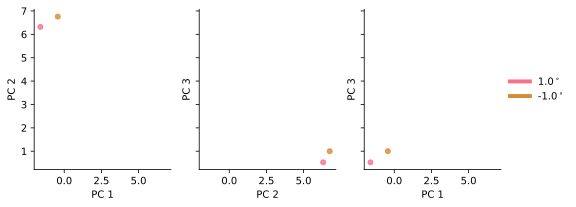

In [46]:
Xr = np.vstack([t[:, :].mean(axis=1) for t in trials]).T

# or take the max
#Xr = np.vstack([t[:, frames_pre_stim:-frames_post_stim].max(axis=1) for t in trials]).T

# or the baseline-corrected mean
#Xr = np.vstack([t[:, frames_pre_stim:-frames_post_stim].mean(axis=1) - t[:, 0:frames_pre_stim].mean(axis=1) for t in trials]).T

Xr_sc = z_score(Xr)

pca = PCA(n_components=15)
Xp = pca.fit_transform(Xr_sc.T).T

projections = [(0, 1), (1, 2), (0, 2)]
fig, axes = plt.subplots(1, 3, figsize=[9, 3], sharey='row', sharex='row')
for ax, proj in zip(axes, projections):
    for t, t_type in enumerate(action_types):
        x = Xp[proj[0], action_type_ind[t]]
        y = Xp[proj[1], action_type_ind[t]]
        ax.scatter(x, y, c=pal[t], s=25, alpha=0.8)
        ax.set_xlabel('PC {}'.format(proj[0]+1))
        ax.set_ylabel('PC {}'.format(proj[1]+1))
sns.despine(fig=fig, top=True, right=True)
add_orientation_legend(axes[2])

# Trial Average PCA

In [58]:
# first compute the trial averages for each trial type and concatenate them
trial_averages = []
for ind in action_type_ind:
    trial_averages.append(np.array(trials)[ind].mean(axis=0))
Xa = np.hstack(trial_averages)

# fit and apply PCA to the resulting data matrix.
n_components = 15
Xa = z_score(Xa) #Xav_sc = center(Xav)
pca = PCA(n_components=n_components)
Xa_p = pca.fit_transform(Xa.T).T

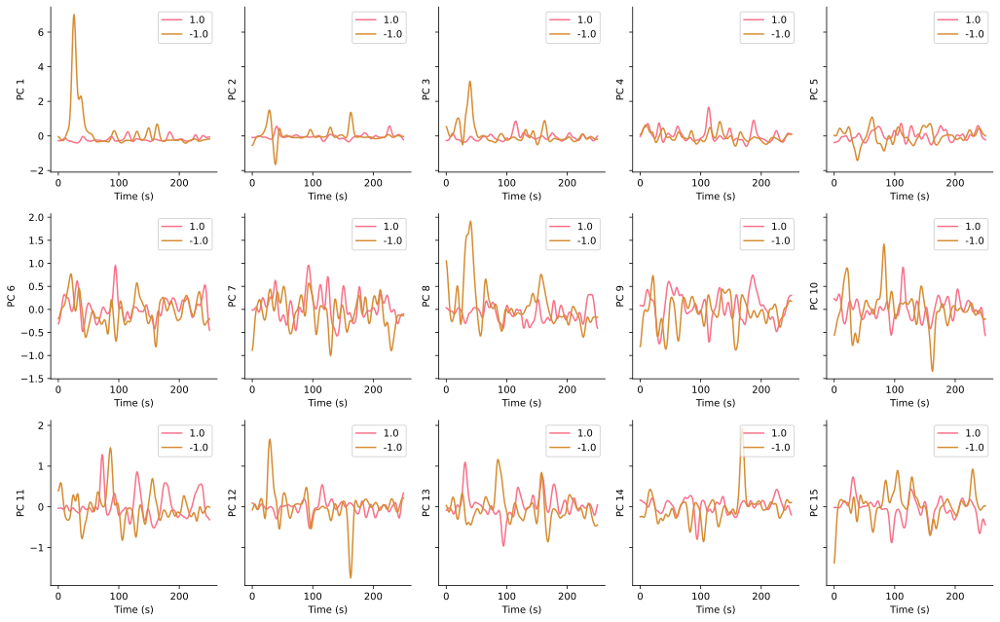

In [76]:
def add_orientation_legend(ax):
    # Assuming this function adds a specific orientation legend
    # This is a placeholder implementation, replace it with actual logic
    ax.legend(action_types, loc='upper right')
fig, axes = plt.subplots(3, 5, figsize=[9.5, 9], sharey='row')
axes = axes.flatten()
for comp in range(15):
    ax = axes[comp]
    for kk, type in enumerate(action_types):
        x = Xa_p[comp, kk * trial_size :(kk+1) * trial_size]
        x = gaussian_filter1d(x, sigma=3)
        ax.plot(time, x, c=pal[kk])
    # add_stim_to_plot(ax)
    ax.set_ylabel('PC {}'.format(comp+1))
    ax.set_xlabel('Time (s)')
    add_orientation_legend(ax)
# add_orientation_legend(axes[2])
sns.despine(fig=fig, right=True, top=True)
plt.tight_layout(rect=[0, 0, 1.5, 1])

# Trial concatenated PCA

In [79]:
#  stack all the trials (the order doesn't matter).
Xl = np.hstack(trials)
# standardize the resulting matrix Xl, and fit and apply PCA to it.
Xl = z_score(Xl)
pca = PCA(n_components=15)
Xl_p = pca.fit_transform(Xl.T).T

# Our projected data Xl_p is in the form of a Q×TK array (number of components by number of time points times number of trials). To plot the components, I rearrange it into a dictionary:
gt = {comp : {t_type : [] for t_type in action_types} for comp in range(n_components)}

for comp in range(n_components):
    for i, t_type in enumerate(actions):
        t = Xl_p[comp, trial_size * i: trial_size * (i + 1)]
        gt[comp][t_type].append(t)

for comp in range(n_components):
    for t_type in action_types:
        gt[comp][t_type] = np.vstack(gt[comp][t_type])

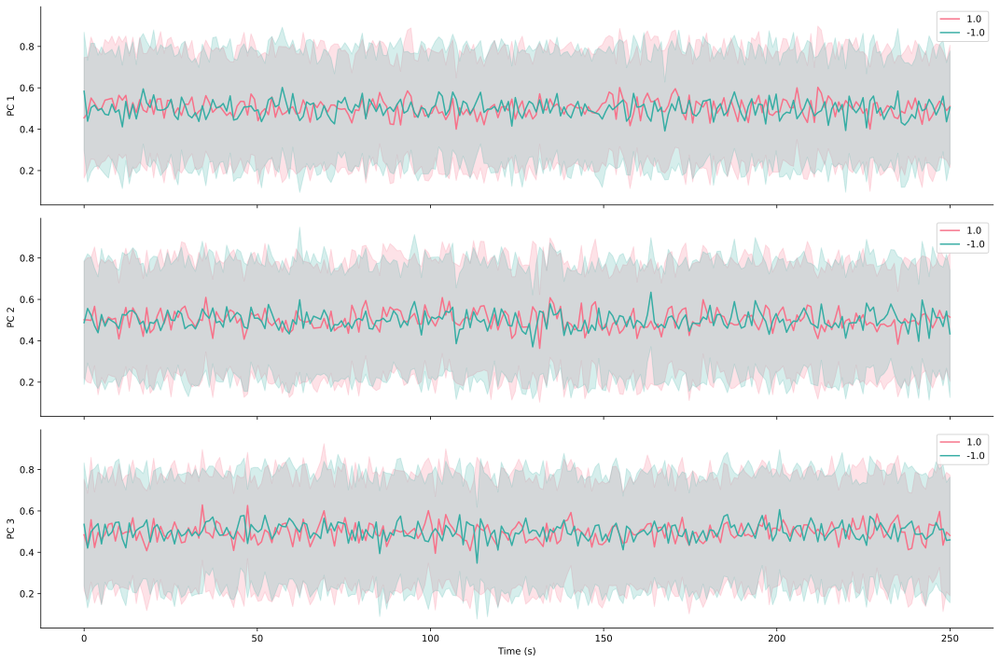

In [103]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Sample data for illustration
import numpy as np
# time = np.linspace(0, 1, 100)
# action_types = ['type1', 'type2', 'type3']  # Assuming 3 action types
pal = sns.color_palette("husl", len(action_types))  # Color palette

# Assuming gt is a dictionary of the form gt[component][type] -> data
gt = {
    comp: {t_type: np.random.rand(50, 250) for t_type in action_types}
    for comp in range(3)
}

def add_orientation_legend(ax):
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, action_types, loc='upper right')

f, axes = plt.subplots(3, 1, figsize=[15, 10], sharey=True, sharex=True)
for comp in range(3):
    ax = axes[comp]
    for t, t_type in enumerate(action_types):
        data = gt[comp][t_type]
        df = pd.DataFrame(data.T, index=time)
        df = df.melt(var_name='trial', value_name='value', ignore_index=False)
        df['time'] = df.index
        sns.lineplot(data=df, x='time', y='value', ci='sd', ax=ax, color=pal[t], label=t_type)
    ax.set_ylabel('PC {}'.format(comp + 1))
    ax.set_xlabel('Time (s)')
    add_orientation_legend(ax)

sns.despine(right=True, top=True)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

# Averaged concatenated PCA

In [90]:
# fit PCA on trial averages
trial_averages = []
for ind in action_type_ind:
    trial_averages.append(np.array(trials)[ind].mean(axis=0))
Xav = np.hstack(trial_averages)

ss = StandardScaler(with_mean=True, with_std=True)
Xav_sc = ss.fit_transform(Xav.T).T
pca = PCA(n_components=15) 
pca.fit(Xav_sc.T) # only call the fit method

PCA(n_components=15)

In [91]:
projected_trials = []
for trial in trials:
    # scale every trial using the same scaling applied to the averages 
    trial = ss.transform(trial.T).T
    # project every trial using the pca fit on averages
    proj_trial = pca.transform(trial.T).T
    projected_trials.append(proj_trial)

In [94]:
gt = {comp: {t_type: [] for t_type in action_types}
      for comp in range(n_components)}

for comp in range(n_components):
    for i, t_type in enumerate(actions):
        t = projected_trials[i][comp, :]
        gt[comp][t_type].append(t)

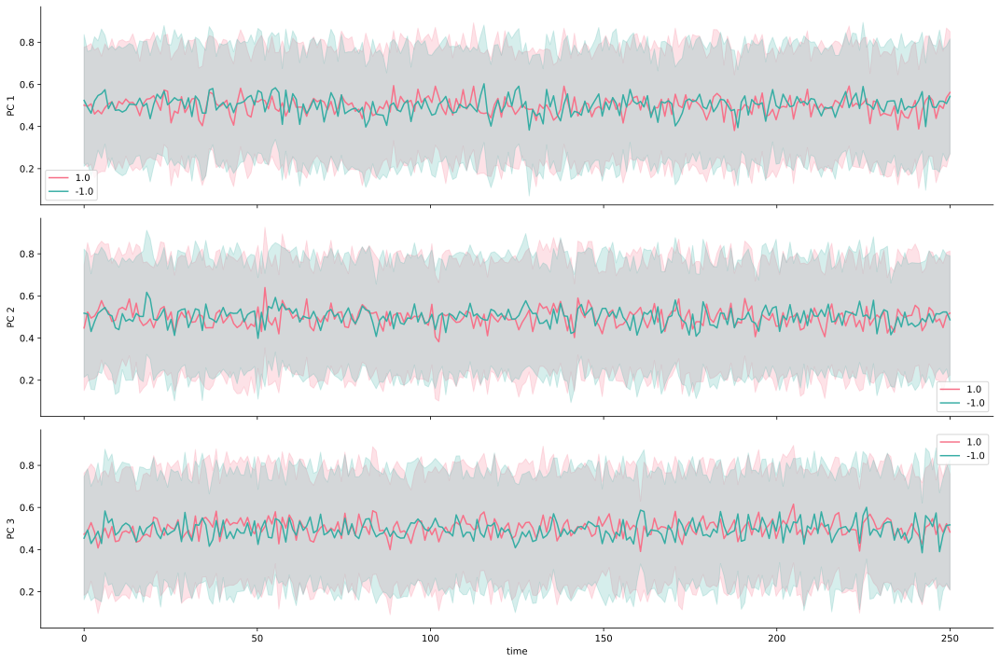

In [104]:
# Sample data for illustration
pal = sns.color_palette("husl", len(action_types))  # Color palette

# Assuming gt is a dictionary of the form gt[component][type] -> data
gt = {
    comp: {t_type: np.random.rand(50, 250) for t_type in action_types}
    for comp in range(3)
}

def add_orientation_legend(ax):
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, action_types, loc='upper right')

f, axes = plt.subplots(3, 1, figsize=[15, 10], sharey=True, sharex=True)

for comp in range(3):
    ax = axes[comp]
    for t, t_type in enumerate(action_types):
        data = gt[comp][t_type]
        # Convert data to long-form DataFrame for seaborn lineplot
        df = pd.DataFrame(data.T, index=time)
        df = df.melt(var_name='trial', value_name='value', ignore_index=False)
        df['time'] = df.index
        
        sns.lineplot(data=df, x='time', y='value', ci='sd', ax=ax, color=pal[t], label=t_type)
        
    ax.set_ylabel('PC {}'.format(comp + 1))

axes[1].set_xlabel('Time (s)')
sns.despine(right=True, top=True)
add_orientation_legend(axes[2])
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()


# Animated Scatter

In [112]:
# import the animation and the HTML module to create and render the animation
from matplotlib import animation 
from IPython.display import HTML

# smooth the single projected trials 
for i in range(len(projected_trials)):
    for c in range(projected_trials[0].shape[0]):
        projected_trials[i][c, :] = gaussian_filter1d(projected_trials[i][c, :], sigma=3)

# for every time point (imaging frame) get the position in PCA space of every trial
pca_frame = []
for t in range(trial_size):
    # projected data for all trials at time t 
    Xp = np.hstack([tr[:, None, t] for tr in projected_trials]).T
    pca_frame.append(Xp)
    
subspace = (1, 2) # pick the subspace given by the second and third components
    
# set up the figure
fig, ax = plt.subplots(1, 1, figsize=[6, 6]); plt.close()
ax.set_xlim(( -2, 2))
ax.set_ylim((-2, 2))
ax.set_xlabel('PC 2')
ax.set_xticks([-2, -1, 0, 1, 2])
ax.set_yticks([-2, -1, 0, 1, 2])
ax.set_ylabel('PC 3')
sns.despine(fig=fig, top=True, right=True)

# generate empty scatter plot to be filled by data at every time point
scatters = []
for t, t_type in enumerate(action_types):
    scatter, = ax.plot([], [], 'o', lw=2, color=pal[t]);
    scatters.append(scatter)

# red dot to indicate when stimulus is being presented
# stimdot, = ax.plot([], [], 'o', c='r', markersize=35, alpha=0.5)

# annotate with stimulus and time information
text     = ax.text(1.5, 1.5, 't = {:.2f}'.format(time[0]), fontdict={'fontsize':14})

# this is the function to be called at every animation frame
def animate(i):
    for t, t_type in enumerate(action_types):
        # find the x and y position of all trials of a given type
        x = pca_frame[i][action_type_ind[t], subspace[0]]
        y = pca_frame[i][action_type_ind[t], subspace[1]]
        # update the scatter
        scatters[t].set_data(x, y)
        
    # update stimulus and time annotation
    if (i > 50) and (i < 150):
        # stimdot.set_data(10, 14)
        text.set_text('t = {:.2f}'.format(time[i]))
    else:
        # stimdot.set_data([], [])
        text.set_text('t = {:.2f}'.format(time[i]))
    return (scatter,)

# generate the animation
anim = animation.FuncAnimation(fig, animate, 
                               frames=len(pca_frame), interval=80, 
                               blit=False)

HTML(anim.to_jshtml()) # render animation

# 3D PCA trajectories

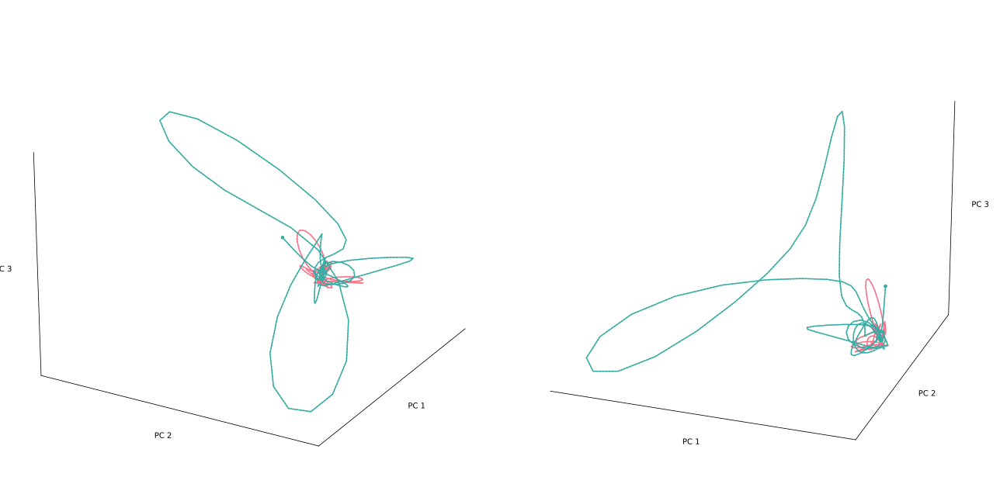

In [120]:
# prepare trial averages
trial_averages = []
for ind in action_type_ind:
    trial_averages.append(np.array(trials)[ind].mean(axis=0))
Xa = np.hstack(trial_averages)

# standardize and apply PCA
Xa = z_score(Xa) 
pca = PCA(n_components=3)
Xa_p = pca.fit_transform(Xa.T).T

# pick the components corresponding to the x, y, and z axes
component_x = 0
component_y = 1
component_z = 2

# create a boolean mask so we can plot activity during stimulus as 
# solid line, and pre and post stimulus as a dashed line
# stim_mask = ~np.logical_and(np.arange(trial_size) >= frames_pre_stim,
#                np.arange(trial_size) < (trial_size-frames_post_stim))

# utility function to clean up and label the axes
def style_3d_ax(ax):
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.xaxis.pane.fill = False
    ax.yaxis.pane.fill = False
    ax.zaxis.pane.fill = False
    ax.xaxis.pane.set_edgecolor('w')
    ax.yaxis.pane.set_edgecolor('w')
    ax.zaxis.pane.set_edgecolor('w')
    ax.set_xlabel('PC 1')
    ax.set_ylabel('PC 2')
    ax.set_zlabel('PC 3')

sigma = 3 # smoothing amount

# set up a figure with two 3d subplots, so we can have two different views
fig = plt.figure(figsize=[18, 10])
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
ax2 = fig.add_subplot(1, 2, 2, projection='3d')
axs = [ax1, ax2]

for ax in axs:
    for t, t_type in enumerate(action_types):

        # for every trial type, select the part of the component
        # which corresponds to that trial type:
        x = Xa_p[component_x, t * trial_size :(t+1) * trial_size]
        y = Xa_p[component_y, t * trial_size :(t+1) * trial_size]
        z = Xa_p[component_z, t * trial_size :(t+1) * trial_size]
        
        # apply some smoothing to the trajectories
        x = gaussian_filter1d(x, sigma=sigma)
        y = gaussian_filter1d(y, sigma=sigma)
        z = gaussian_filter1d(z, sigma=sigma)

        # use the mask to plot stimulus and pre/post stimulus separately
        z_stim = z.copy()
        # z _stim[stim_mask] = np.nan
        z_prepost = z.copy()
        # z_prepost[~stim_mask] = np.nan

        ax.plot(x, y, z_stim, c = pal[t])
        ax.plot(x, y, z_prepost, c=pal[t], ls=':')
        
        # plot dots at initial point
        ax.scatter(x[0], y[0], z[0], c=pal[t], s=14)
        
        # make the axes a bit cleaner
        style_3d_ax(ax)
        
# specify the orientation of the 3d plot        
ax1.view_init(elev=22, azim=30)
ax2.view_init(elev=22, azim=110)
plt.tight_layout()

# Animated PCA trajectories in 3D

In [124]:
# apply some smoothing to the trajectories
for c in range(Xa_p.shape[0]):
    Xa_p[c, :] =  gaussian_filter1d(Xa_p[c, :], sigma=sigma)

# create the figure
fig = plt.figure(figsize=[9, 9]); plt.close()
ax = fig.add_subplot(1, 1, 1, projection='3d')

def animate(i):
    
    ax.clear() # clear up trajectories from previous iteration
    style_3d_ax(ax)
    ax.view_init(elev=22, azim=30)

    for t, t_type in enumerate(action_types):
    
        x = Xa_p[component_x, t * trial_size :(t+1) * trial_size][0:i]
        y = Xa_p[component_y, t * trial_size :(t+1) * trial_size][0:i]
        z = Xa_p[component_z, t * trial_size :(t+1) * trial_size][0:i]
                
        # stim_mask = ~np.logical_and(np.arange(z.shape[0]) >= frames_pre_stim,
        #              np.arange(z.shape[0]) < (trial_size-frames_pre_stim))

        z_stim = z.copy()
        # z_stim[stim_mask] = np.nan
        z_prepost = z.copy()
        # z_prepost[~stim_mask] = np.nan
        
        ax.plot(x, y, z_stim, c = pal[t])
        ax.plot(x, y, z_prepost, c=pal[t], ls=':')

    ax.set_xlim(( -3, 3))
    ax.set_ylim((-3, 3))
    ax.set_zlim((-3, 3))

    return []


anim = animation.FuncAnimation(fig, animate,
                               frames=len(pca_frame), interval=50, 
                               blit=True)

HTML(anim.to_jshtml(default_mode='once'))

# Animated PCA trajectories of single trials in 3D

In [123]:
# set up a dictionary to color each line
col = {action_types[i] : pal[i] for i in range(len(action_types))}


fig = plt.figure(figsize=[9, 9]); plt.close()
ax = fig.add_subplot(1, 1, 1, projection='3d')

def animate(i):
    
    ax.clear()
    style_3d_ax(ax)
    ax.view_init(elev=22, azim=30)
    for t, (trial, t_type) in enumerate(zip(projected_trials[0:40], actions[0:40])):
        
        x = trial[component_x, :][0:i]
        y = trial[component_y, :][0:i]
        z = trial[component_z, :][0:i]
        
        # stim_mask = ~np.logical_and(np.arange(z.shape[0]) >= frames_pre_stim,
        #              np.arange(z.shape[0]) < (trial_size-frames_pre_stim))

        z_stim = z.copy()
        # z_stim[stim_mask] = np.nan
        z_prepost = z.copy()
        # z_prepost[~stim_mask] = np.nan
        
        ax.plot(x, y, z_stim, c = col[t_type])
        ax.plot(x, y, z_prepost, c=col[t_type], ls=':')

    ax.set_xlim(( -3, 3))
    ax.set_ylim((-3, 3))
    ax.set_zlim((-3, 3))
    ax.view_init(elev=22, azim=30)

    return []

anim = animation.FuncAnimation(fig, animate, frames=len(pca_frame), interval=50,blit=True)

HTML(anim.to_jshtml(default_mode='once'))